# tensorflow-gun-detection Object Detection Demo
## Model preparation
### Download Model

In [1]:
from google_drive_downloader import GoogleDriveDownloader



GoogleDriveDownloader.download_file_from_google_drive(file_id="1EJv1h6uK8k_f2Nz5MmgwN3i2FJn2Nwmv", 
                                                      dest_path="./faster_rcnn/faster_rcnn_inception_v2_graph_output.zip",
                                                      unzip=True)

Unzipping...Done.


### Variables

In [2]:
from pathlib import Path



MODEL_NAME = "faster_rcnn/faster_rcnn_inception_v2_graph_output"
PATH_TO_FROZEN_GRAPH = MODEL_NAME + '/frozen_inference_graph.pb'

PATH_TO_LABELS = Path("__file__").parent.joinpath("faster_rcnn").joinpath("training").joinpath("object-detection.pbtxt")

### Load a (frozen) Tensorflow model into memory.

In [3]:
import tensorflow


detection_graph = tensorflow.Graph()
with detection_graph.as_default():
    od_graph_def = tensorflow.GraphDef()
    with tensorflow.io.gfile.GFile(PATH_TO_FROZEN_GRAPH, "rb") as g_file:
        serialized_graph = g_file.read()
        print(serialized_graph[:100])
        od_graph_def.ParseFromString(serialized_graph)
        tensorflow.import_graph_def(od_graph_def, name="")

b'\n:\n\x05Const\x12\x05Const*\x1d\n\x05value\x12\x14B\x12\x08\x03\x12\x04\x12\x02\x08\x02"\x08\x00\x01\x00\x00\x00\x01\x00\x00*\x0b\n\x05dtype\x12\x020\x03\n.\n\x07ToFloat\x12\x04Cast\x1a\x05Const*\n\n\x04SrcT\x12\x020\x03*\n\n\x04'


### Loading label map

In [4]:
category_index = {1: {'id': 1, 'name': 'gun'}}

#### Helper code

In [5]:
import numpy

from PIL import Image


def load_image_into_numpy_array(image: Image) -> numpy.ndarray:
    (im_width, im_height) = image.size
    array_image = numpy.array(image.getdata())
    if (len(array_image.shape) < 2) or (array_image.shape[1] > 3):
        image = image.convert("RGB")
        array_image = numpy.array(image.getdata())
    return array_image.reshape((im_height, im_width, 3)).astype(numpy.uint8)

### Download first 10 images from Google image search with the query "guns"

In [6]:
!mkdir images
!cd images && wget https://www.thetrace.org/wp-content/uploads/2019/05/ghostgun-03.jpg \
    https://laistassets.scprdev.org/i/9a8b93e9459b86a780e248c3d505d7e2/5cd4c204089291000912f215-eight.jpg \
    https://images-na.ssl-images-amazon.com/images/I/81%2Bt1PuTGyL._SX425_.jpg \
    https://www.thetrace.org/wp-content/uploads/2016/01/shutterstock_220531096.jpg \
    https://www.rollingstone.com/wp-content/uploads/2019/08/ROLLING_STONE_GUNS_AGNEW.jpg \
    https://www.sciencefriday.com/wp-content/uploads/2016/06/shutterstock_355805132-min-1.jpg \
    https://nationalinterest.org/sites/default/files/styles/desktop__1260_/public/main_images/1200px-SIG_Sauer_P226_E2_-_10rd_Magazine.jpg \
    https://rentalhousingjournal.com/wp-content/uploads/2018/09/3-5-18%20can%20i%20say%20no%20guns%20in%20my%20apartments%20photo%20credit%20MariuszBlach%20istock.png \
    https://www.cheaperthandirt.com/on/demandware.static/-/Sites-ctd-site-catalog/default/dw59389476/images/Tactical-Image.jpg \
    https://nationalinterest.org/sites/default/files/styles/desktop__1260_/public/main_images/RTS1ORG3_3.jpg \
    https://media.pri.org/s3fs-public/styles/story_main/public/story/images/Screen%20Shot%202016-06-20%20at%203.22.42%20PM.png \
    https://d.newsweek.com/en/full/628132/gun-violence.jpg \
    https://thumbs.dreamstime.com/z/elegant-people-weapons-group-young-79989258.jpg \
    https://www.wallpaperup.com/uploads/wallpapers/2012/11/27/22792/1097af6af7e9c7fe5c6bdb9bde6f5569-700.jpg \
    https://ichef.bbci.co.uk/images/ic/720x405/p05yxkq1.jpg \
    https://i.kinja-img.com/gawker-media/image/upload/s--BPL7KRNw--/c_scale,f_auto,fl_progressive,q_80,w_800/iralotbeakxefd5s5kab.png \
    https://wamu.org/wp-content/uploads/2017/08/36550894875_395d1c1f39_k-1500x1000.jpg \
    https://specials-images.forbesimg.com/imageserve/5d792a4baea4d30008f0b152/960x0.jpg \
    https://timedotcom.files.wordpress.com/2018/02/gettyimages-92931942.jpeg \
    https://media.wnyc.org/i/800/0/c/85/1/GettyImages-152404530.jpg \
    https://www.straitstimes.com/sites/default/files/styles/article_pictrure_780x520_/public/articles/2017/05/05/ST_20170505_ISIS05_3120386.jpg \
    https://i0.wp.com/metro.co.uk/wp-content/uploads/2018/07/sei_23090916-9936.jpg

mkdir: cannot create directory ‘images’: File exists
--2019-10-02 13:37:53--  https://www.thetrace.org/wp-content/uploads/2019/05/ghostgun-03.jpg
Resolving www.thetrace.org (www.thetrace.org)... 104.20.137.25, 104.20.136.25, 2606:4700:10::6814:8919, ...
Connecting to www.thetrace.org (www.thetrace.org)|104.20.137.25|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2362011 (2.3M) [image/jpeg]
Saving to: ‘ghostgun-03.jpg’

ghostgun-03.jpg     100%[===================>]   2.25M  1.23MB/s    in 1.8s    

2019-10-02 13:37:56 (1.23 MB/s) - ‘ghostgun-03.jpg’ saved [2362011/2362011]

--2019-10-02 13:37:56--  https://laistassets.scprdev.org/i/9a8b93e9459b86a780e248c3d505d7e2/5cd4c204089291000912f215-eight.jpg
Resolving laistassets.scprdev.org (laistassets.scprdev.org)... 54.192.102.41, 54.192.102.44, 54.192.102.83, ...
Connecting to laistassets.scprdev.org (laistassets.scprdev.org)|54.192.102.41|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: u

## Visualization method

In [7]:
from matplotlib import pyplot
from tensorflow.models.research.object_detection.utils import visualization_utils



def label_and_visualize_image(path_to_image: Path) -> None:
    with tensorflow.Session(graph=detection_graph) as sess:
        ops = detection_graph.get_operations()
        all_tensor_names = {output.name for op in ops for output in op.outputs}
        tensor_dict = {}
        for key in ['num_detections', 'detection_boxes', 'detection_scores', 'detection_classes', 'detection_masks']:
            tensor_name = key + ':0'
            if tensor_name in all_tensor_names:
                tensor_dict[key] = detection_graph.get_tensor_by_name(tensor_name)
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        image = Image.open(str(path_to_image))
        image_np = load_image_into_numpy_array(image)
        image_np_expanded = numpy.expand_dims(image_np, axis=0)
        output_dict = sess.run(tensor_dict, feed_dict={image_tensor: image_np_expanded})
    output_dict['num_detections'] = int(output_dict['num_detections'][0])
    output_dict['detection_classes'] = output_dict['detection_classes'][0].astype(numpy.int64)
    output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
    output_dict['detection_scores'] = output_dict['detection_scores'][0]
    
    visualization_utils.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      line_thickness=8)
    pyplot.figure(figsize=(24,16))
    pyplot.imshow(image_np)
    pyplot.show()

extract all the paths:

In [8]:
images_path = Path("__file__").parent.joinpath("images")
files = [x for x in images_path.iterdir() if x.is_file()]
files

[PosixPath('images/sei_23090916-9936.jpg'),
 PosixPath('images/ghostgun-03.jpg'),
 PosixPath('images/p05yxkq1.jpg'),
 PosixPath('images/gettyimages-92931942.jpeg'),
 PosixPath('images/shutterstock_220531096.jpg'),
 PosixPath('images/3-5-18 can i say no guns in my apartments photo credit MariuszBlach istock.png'),
 PosixPath('images/shutterstock_355805132-min-1.jpg'),
 PosixPath('images/GettyImages-152404530.jpg'),
 PosixPath('images/Screen Shot 2016-06-20 at 3.22.42 PM.png'),
 PosixPath('images/36550894875_395d1c1f39_k-1500x1000.jpg'),
 PosixPath('images/960x0.jpg'),
 PosixPath('images/ST_20170505_ISIS05_3120386.jpg'),
 PosixPath('images/5cd4c204089291000912f215-eight.jpg'),
 PosixPath('images/ROLLING_STONE_GUNS_AGNEW.jpg'),
 PosixPath('images/iralotbeakxefd5s5kab.png'),
 PosixPath('images/81+t1PuTGyL._SX425_.jpg'),
 PosixPath('images/Tactical-Image.jpg'),
 PosixPath('images/gun-violence.jpg'),
 PosixPath('images/elegant-people-weapons-group-young-79989258.jpg')]

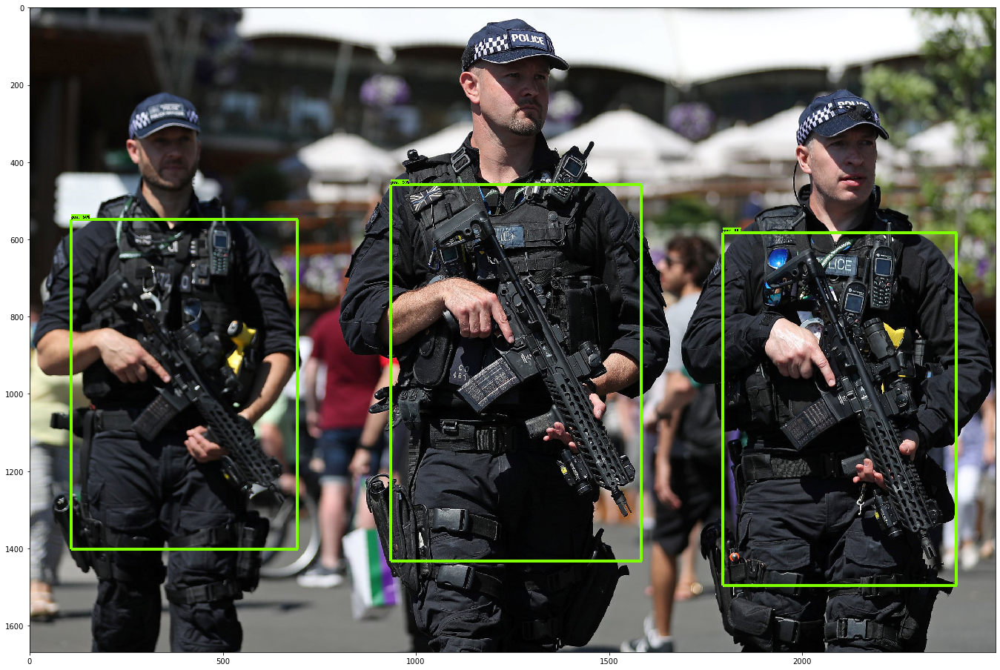

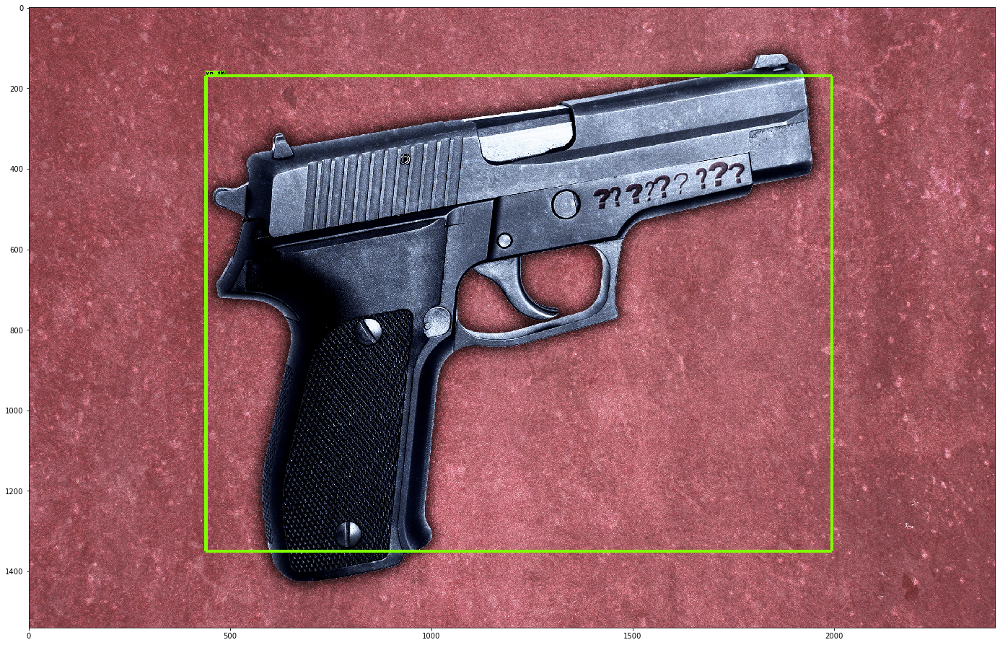

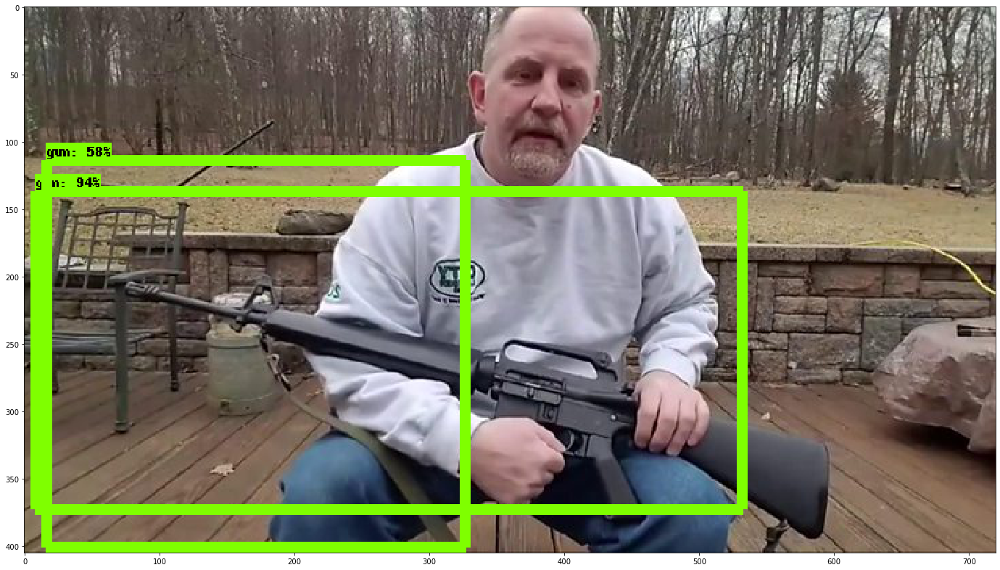

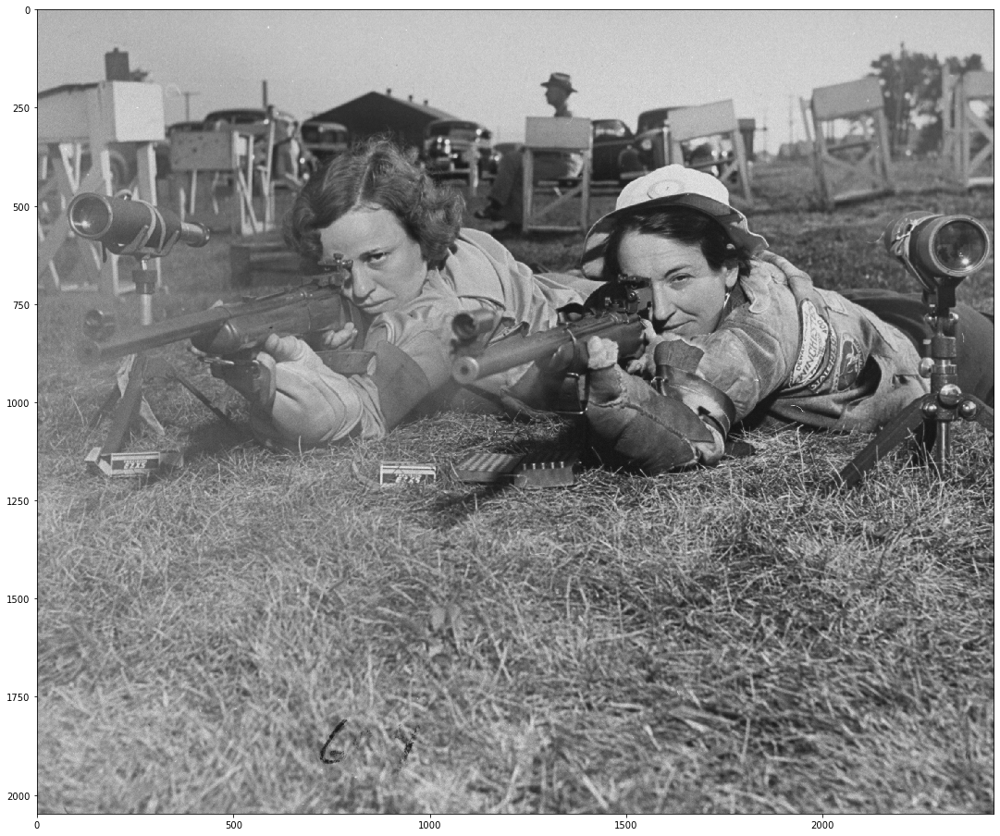

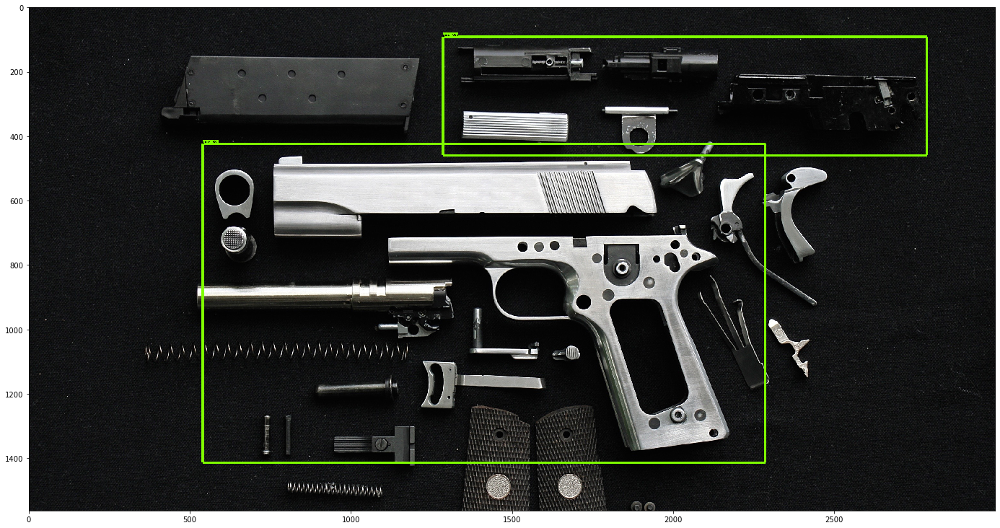

...

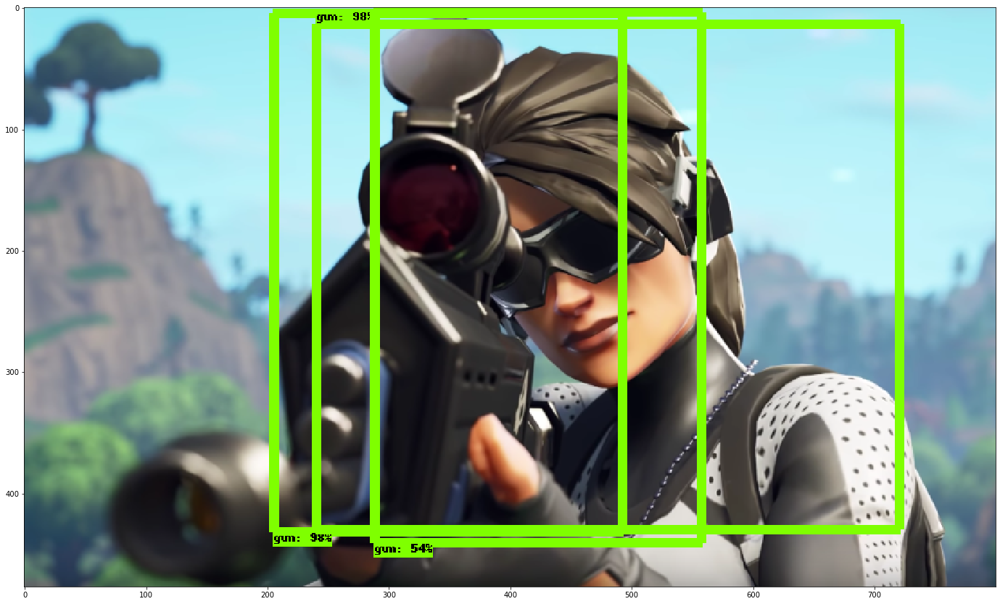

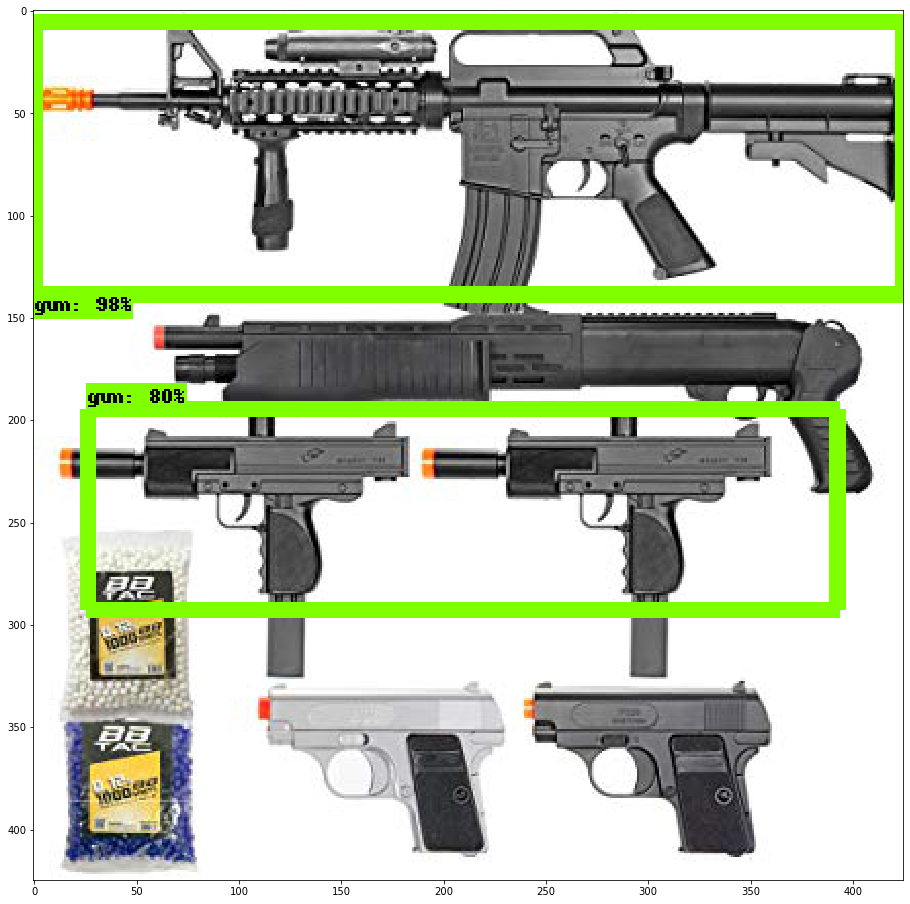

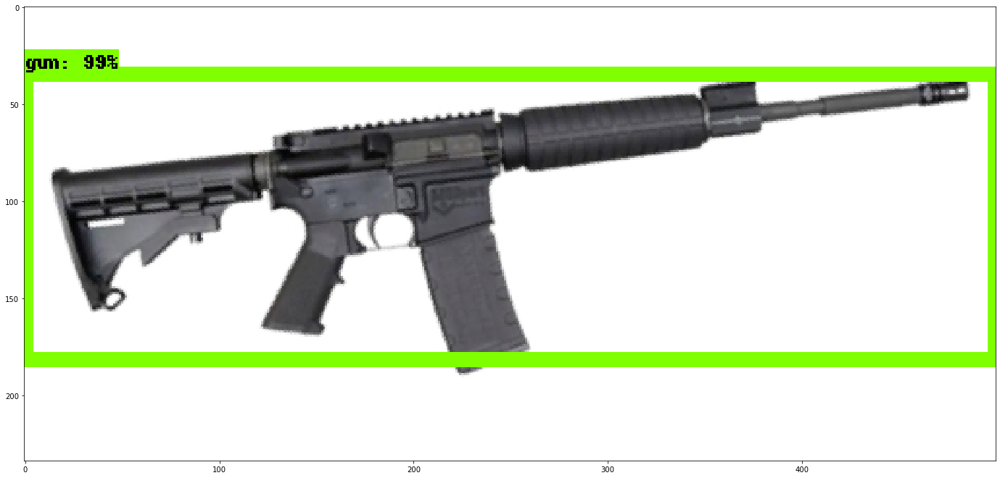

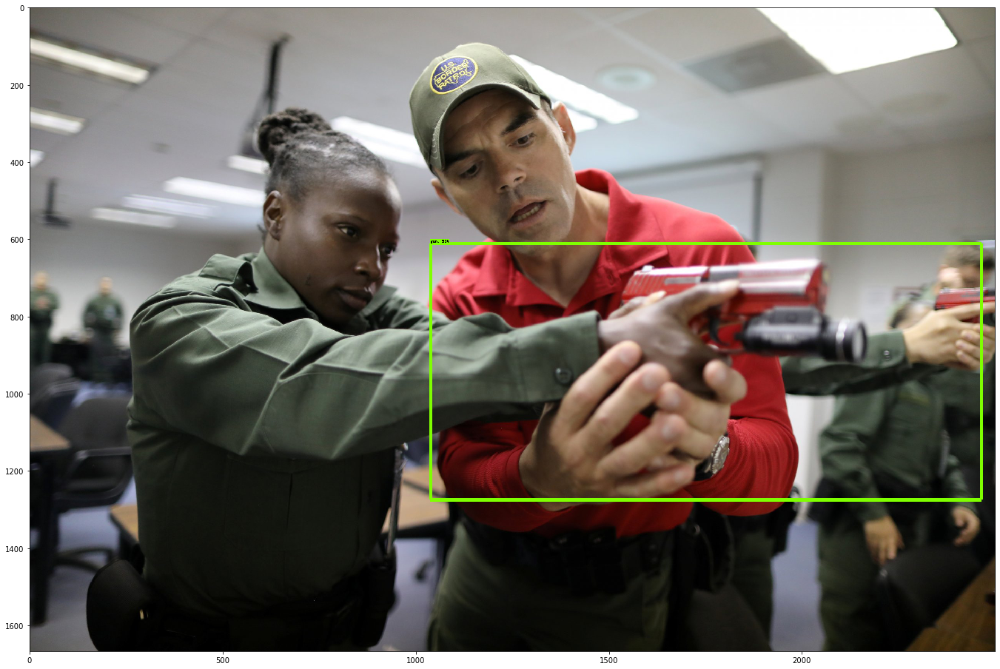

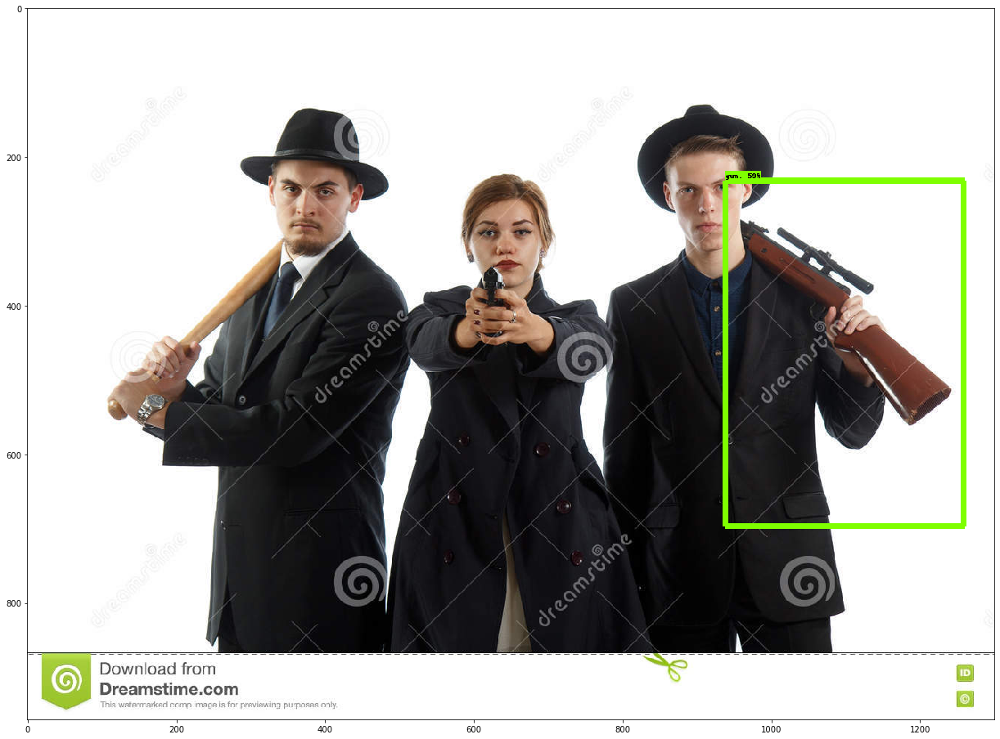

In [9]:
for image_path in files:
    label_and_visualize_image(image_path)